<a href="https://colab.research.google.com/github/MathewBiddle/sandbox/blob/main/notebooks/union_RA_boundary_and_sanctuaries.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install folium matplotlib mapclassify

Read Office of National Marine Sanctuaries boundary polygons

In [1]:
import geopandas as gpd

onms_url = 'https://services2.arcgis.com/C8EMgrsFcRFL6LrL/ArcGIS/rest/services/NOAA_National_Marine_Sanctuaries_(2023)_/FeatureServer/0/query?f=json&outfields=*&where=1%3D1'

onms = gpd.read_file(onms_url)

onms

,FID,OBJECTID,Site_ID,Site_Name,Gov_Level,State,Prot_Lvl,Mgmt_Agen,Mgmt_Plan,Pri_Con_Fo,...,MarPercent,AreaNT,Longitude,Latitude,VxCount,SHAPE_Leng,SHAPE_Area,Shape__Area,Shape__Length,geometry
0,281,281,NMS4,Florida Keys National Marine Sanctuary,Federal,FL,Zoned w/No Take Areas,NOAA National Marine Sanctuary Program,Site-Specific Management Plan,Natural Heritage,...,100,1222.346469,-81.717467,24.693315,39690,32.946354,1.199400e+10,1.199400e+10,3.827872e+06,"MULTIPOLYGON (((-9248794.323 2790007.259, -925..."
1,315,315,NMS3,National Marine Sanctuary of American Samoa,Federal,ASM,Zoned w/No Take Areas,NOAA National Marine Sanctuary Program & Ameri...,Site-Specific Management Plan,Natural Heritage,...,100,0.006851,-168.165495,-14.527123,2833,8.253789,3.770411e+10,3.770411e+10,9.327464e+05,"MULTIPOLYGON (((-19009532.902 -1615734.156, -1..."
2,318,318,NMS7,Gray's Reef National Marine Sanctuary,Federal,GA,Zoned w/No Take Areas,NOAA National Marine Sanctuary Program,Site-Specific Management Plan,Natural Heritage,...,100,21.374000,-80.874675,31.391905,7,0.302773,7.879795e+07,7.879795e+07,3.593139e+04,"POLYGON ((-8997748.180 3679947.966, -9008107.0..."
3,328,328,NMS1,Channel Islands National Marine Sanctuary,Federal,CA,Zoned w/No Take Areas,NOAA National Marine Sanctuary Program,Site-Specific Management Plan,Natural Heritage,...,100,807.101193,-119.837293,33.945118,7883,6.907226,5.541770e+09,5.541770e+09,8.145536e+05,"MULTIPOLYGON (((-13237548.342 3965123.293, -13..."
4,329,329,NMS10,NOAA's Monitor National Marine Sanctuary,Federal,NC,Uniform Multiple Use,NOAA National Marine Sanctuary Program,Site-Specific Management Plan,Natural Heritage,...,100,0.000000,-75.409588,35.006568,49,0.052323,3.291316e+06,3.291316e+06,6.483832e+03,"POLYGON ((-8394556.937 4165906.373, -8394435.8..."
5,330,330,NMS11,Monterey Bay National Marine Sanctuary,Federal,CA,Zoned Multiple Use,NOAA National Marine Sanctuary Program,Site-Specific Management Plan,Natural Heritage,...,100,0.000000,-122.350496,36.542007,7278,10.602189,2.452208e+10,2.452208e+10,1.322203e+06,"MULTIPOLYGON (((-13636637.622 4232038.463, -13..."
6,331,331,NMS13,Olympic Coast National Marine Sanctuary,Federal,WA,Zoned Multiple Use,NOAA National Marine Sanctuary Program,Site-Specific Management Plan,Natural Heritage,...,100,0.000000,-124.882834,47.822006,2027,5.482345,1.832267e+10,1.832267e+10,7.402021e+05,"POLYGON ((-13990818.784 6148547.161, -13970686..."
7,332,332,NMS6,Gerry E. Studds/Stellwagen Bank National Marin...,Federal,MA,Uniform Multiple Use,NOAA National Marine Sanctuary Program,Site-Specific Management Plan,Natural Heritage,...,100,0.000000,-70.321246,42.404405,29,2.042709,4.022032e+09,4.022032e+09,2.754548e+05,"POLYGON ((-7816480.634 5276530.667, -7796267.6..."
8,333,333,NMS9,Hawaiian Islands Humpback Whale National Marin...,Federal,HI,Uniform Multiple Use,NOAA National Marine Sanctuary Program,Site-Specific Management Plan,Natural Heritage,...,100,0.000000,-157.095891,20.907777,18278,10.473276,4.075662e+09,4.075662e+09,1.200783e+06,"MULTIPOLYGON (((-17349674.281 2308600.514, -17..."
9,547,547,NMS14,Thunder Bay National Marine Sanctuary and Unde...,Federal,MI,Zoned Multiple Use,NOAA National Marine Sanctuary Program,Site-Specific Management Plan,Cultural Heritage,...,100,0.000000,-83.156902,45.179495,105387,8.836263,2.227295e+10,2.227295e+10,1.130399e+06,"POLYGON ((-9293393.526 5743876.891, -9186155.5..."


Read Integrate Ocean Observing Office Regional Association Boundary Polgyons

In [2]:
ioos_url = 'https://erddap.ioos.us/erddap/files/ra_regional_boundaries/ra_region_boundaries.geojson'

ioos_ra = gpd.read_file(ioos_url)

ioos_ra

,RA,geometry
0,AOOS,"MULTIPOLYGON (((-157.02048 74.70510, -156.9577..."
1,CARICOOS,"POLYGON ((-66.66195 21.84095, -66.65406 21.840..."
2,CARICOOS,"POLYGON ((-74.81189 18.42230, -74.81107 18.410..."
3,CeNCOOS,"POLYGON ((-124.20577 41.97632, -124.20368 41.9..."
4,GCOOS,"POLYGON ((-80.37700 24.48368, -80.41000 24.471..."
5,GLOS,"POLYGON ((-80.15328 42.58440, -80.15742 42.585..."
6,MARACOOS,"MULTIPOLYGON (((-76.54411 35.23161, -76.56664 ..."
7,NANOOS,"POLYGON ((-124.00700 40.45530, -124.00670 40.4..."
8,NERACOOS,"POLYGON ((-71.87511 41.07571, -71.90330 41.084..."
9,PacIOOS,"POLYGON ((-165.62222 -14.14928, -165.36861 -15..."


In [10]:
ioos_ra.explore()

Bring in continent polygons

In [3]:
earth = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))

earth

<ipython-input-3-7821e2c2854e>:1: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  earth = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))


,pop_est,continent,name,iso_a3,gdp_md_est,geometry
0,889953.0,Oceania,Fiji,FJI,5496,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,58005463.0,Africa,Tanzania,TZA,63177,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,603253.0,Africa,W. Sahara,ESH,907,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
3,37589262.0,North America,Canada,CAN,1736425,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742..."
4,328239523.0,North America,United States of America,USA,21433226,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."
...,...,...,...,...,...,...
172,6944975.0,Europe,Serbia,SRB,51475,"POLYGON ((18.82982 45.90887, 18.82984 45.90888..."
173,622137.0,Europe,Montenegro,MNE,5542,"POLYGON ((20.07070 42.58863, 19.80161 42.50009..."
174,1794248.0,Europe,Kosovo,-99,7926,"POLYGON ((20.59025 41.85541, 20.52295 42.21787..."
175,1394973.0,North America,Trinidad and Tobago,TTO,24269,"POLYGON ((-61.68000 10.76000, -61.10500 10.890..."


Tranform geometries to WGS84.

In [5]:
onms.explore()

In [6]:
# transform geometry
crs = 'WGS84'

onms = onms.to_crs(crs)
ioos_ra = ioos_ra.to_crs(crs)
earth = earth.to_crs(crs)

We want to find the **intersection** of the IOOS RAs and the Sactuaries polygons.

See https://geopandas.org/en/stable/docs/user_guide/set_operations.html for more information.

In [7]:
union = gpd.overlay(ioos_ra,onms, how='intersection')

Make a static map

<Axes: >

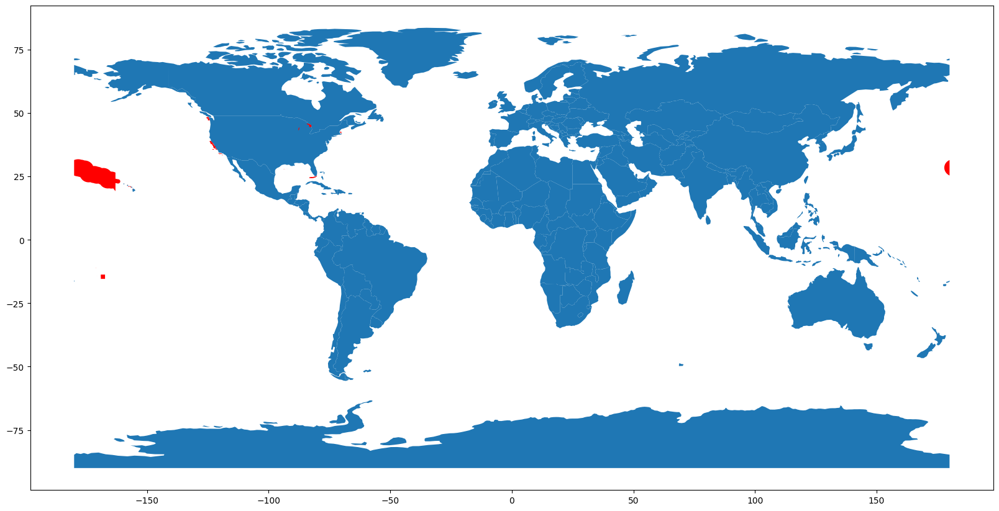

In [8]:
base = earth.plot(figsize=(20,18))

union.plot(ax=base, color='red')

Make an interactive map

In [9]:
union.explore()